<a href="https://colab.research.google.com/github/cxd217/XAI-Robustness-Demo/blob/main/ResNet50_FGSM_Demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import requests
from io import BytesIO
import json

# 1. 设备配置
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"正在使用设备: {device}")

# 2. 加载 ResNet50 模型
print("正在加载 ResNet50 模型...")
model = models.resnet50(pretrained=True)
model.to(device)
model.eval()

# 获取 ImageNet 标签
url_labels = "https://raw.githubusercontent.com/anishathalye/imagenet-simple-labels/master/imagenet-simple-labels.json"
labels = json.loads(requests.get(url_labels).text)

# 3. 图像预处理
preprocess = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# 反归一化（用于显示图片）
def inverse_normalize(tensor):
    inv_normalize = transforms.Normalize(
        mean=[-0.485/0.229, -0.456/0.224, -0.406/0.225],
        std=[1/0.229, 1/0.224, 1/0.225]
    )
    img = inv_normalize(tensor.squeeze()).cpu().detach().permute(1, 2, 0).numpy()
    return np.clip(img, 0, 1)

# --- Grad-CAM 类定义 ---
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None

        self.target_layer.register_forward_hook(self.save_activation)
        self.target_layer.register_full_backward_hook(self.save_gradient)

    def save_activation(self, module, input, output):
        self.activations = output

    def save_gradient(self, module, grad_input, grad_output):
        self.gradients = grad_output[0]

    def __call__(self, x, class_idx=None):
        output = self.model(x)
        if class_idx is None:
            class_idx = torch.argmax(output, dim=1)

        self.model.zero_grad()
        one_hot = torch.zeros_like(output)
        one_hot[0][class_idx] = 1
        output.backward(gradient=one_hot, retain_graph=True)

        pooled_gradients = torch.mean(self.gradients, dim=[0, 2, 3])
        activation = self.activations[0].clone()
        for i in range(activation.shape[0]):
            activation[i, :, :] *= pooled_gradients[i]

        heatmap = torch.mean(activation, dim=0).cpu().detach().numpy()
        heatmap = np.maximum(heatmap, 0) # ReLU
        if np.max(heatmap) != 0:
            heatmap /= np.max(heatmap) # Normalize
        return heatmap, labels[class_idx]

# --- FGSM 攻击函数 ---
def generate_adversarial(model, image_tensor, label_idx, epsilon=0.1):
    image_tensor.requires_grad = True
    output = model(image_tensor)
    loss = nn.CrossEntropyLoss()(output, torch.tensor([label_idx]).to(device))
    model.zero_grad()
    loss.backward()
    data_grad = image_tensor.grad.data
    # FGSM 公式: x_adv = x + epsilon * sign(grad)
    perturbed_image = image_tensor + epsilon * data_grad.sign()
    return perturbed_image.detach() # 返回不需要梯度的 tensor

print("环境准备完毕！请运行下一个单元格。")

正在使用设备: cuda
正在加载 ResNet50 模型...


/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


100%|██████████| 97.8M/97.8M [00:00<00:00, 214MB/s]


环境准备完毕！请运行下一个单元格。


图片加载成功！


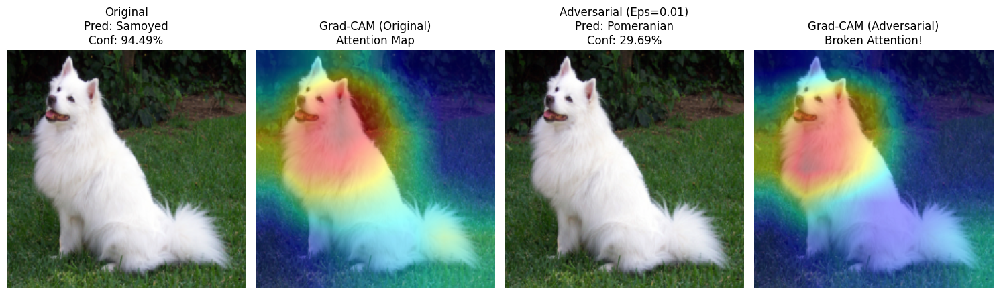

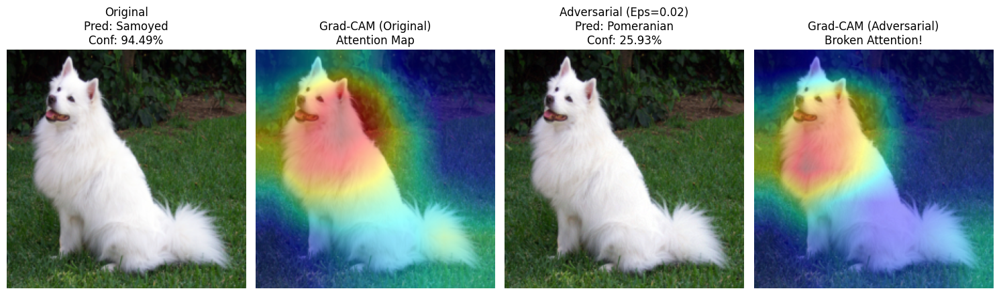

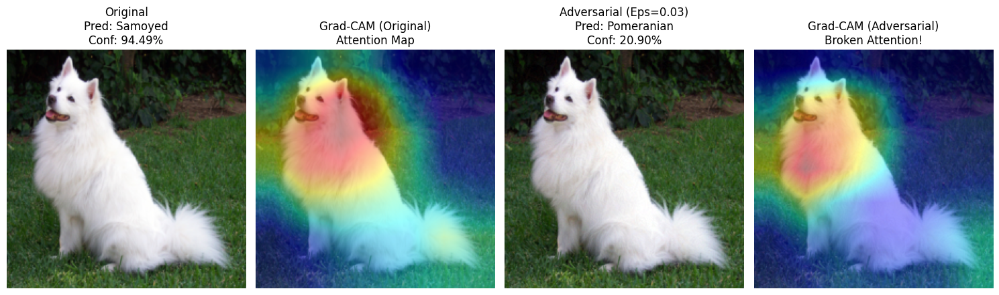

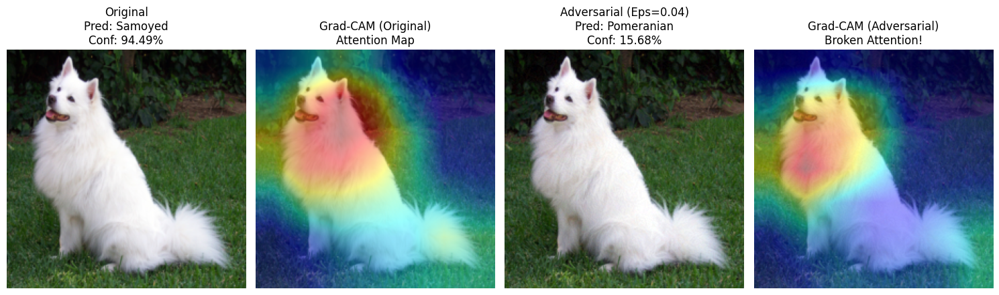

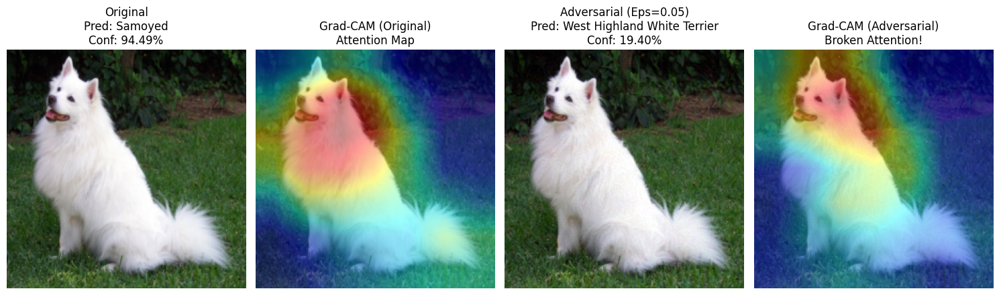

...

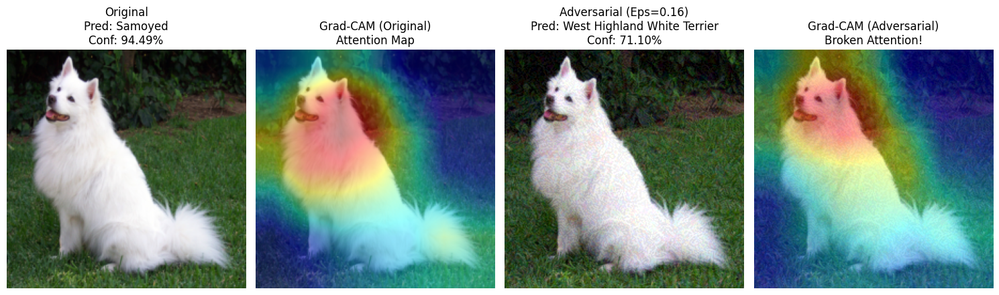

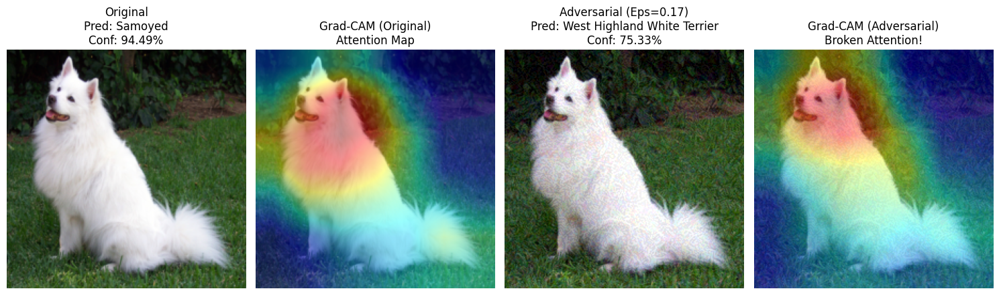

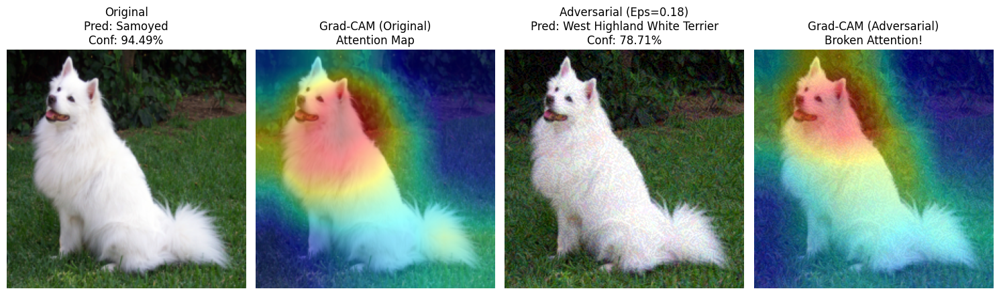

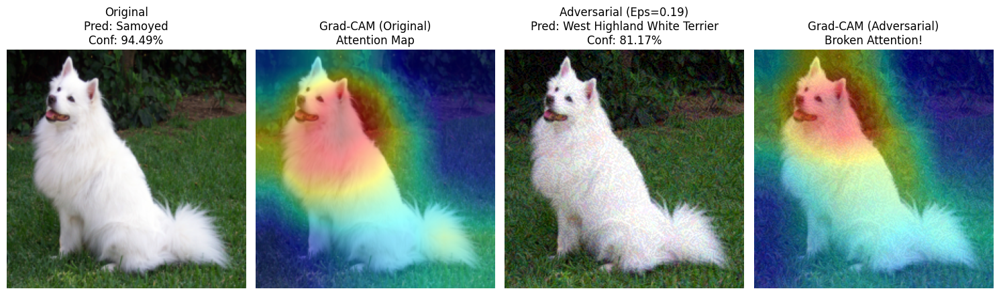

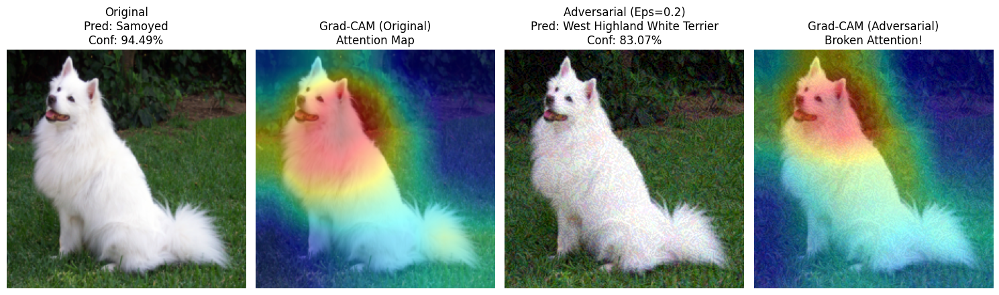

In [ ]:
# --- 5. 可视化绘图 ---
def show_cam_on_image(img_tensor, heatmap):
    img = inverse_normalize(img_tensor)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB) / 255.0
    return heatmap * 0.4 + img * 0.6

# 初始化 Grad-CAM (针对 ResNet50 的 layer4)
grad_cam = GradCAM(model, model.layer4[-1])

# --- 1. 获取图片 ---
# 这是一个非常稳定的 GitHub 图床链接，不会拦截代码访问
img_url = "https://raw.githubusercontent.com/pytorch/hub/master/images/dog.jpg"

# 添加 User-Agent 头，把自己伪装成浏览器（防止某些网站拦截）
headers = {'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/58.0.3029.110 Safari/537.3'}

# stream=True 是个好习惯
response = requests.get(img_url, headers=headers, stream=True)

# 检查一下状态码，确保下载成功了 (200 代表成功)
if response.status_code == 200:
    img_pil = Image.open(BytesIO(response.content))
    print("图片加载成功！")
else:
    print(f"图片下载失败，错误代码: {response.status_code}")
    # 打印出一部分内容看看是啥（通常是 HTML 报错信息）
    print(response.text[:100])

# 处理图片
img_tensor = preprocess(img_pil).unsqueeze(0).to(device)

# --- 2. 原始图片预测 ---
heatmap_orig, label_orig = grad_cam(img_tensor)
orig_conf = torch.nn.functional.softmax(model(img_tensor), dim=1).max().item()

# --- 3. 生成对抗样本 (攻击!) ---
epsilon = 0
while epsilon < 0.2:  # <--- 试着修改这个值 (例如 0.01 到 0.2)
 epsilon = epsilon + 0.01
 adv_tensor = generate_adversarial(model, img_tensor, torch.argmax(model(img_tensor)), epsilon)

 # --- 4. 对抗样本预测 ---
 heatmap_adv, label_adv = grad_cam(adv_tensor)
 adv_conf = torch.nn.functional.softmax(model(adv_tensor), dim=1).max().item()
 plt.figure(figsize=(15, 8))

 # 原始图片
 plt.subplot(1, 4, 1)
 plt.imshow(inverse_normalize(img_tensor))
 plt.title(f"Original\nPred: {label_orig}\nConf: {orig_conf:.2%}")
 plt.axis('off')

 # 原始 Grad-CAM
 plt.subplot(1, 4, 2)
 plt.imshow(show_cam_on_image(img_tensor, heatmap_orig))
 plt.title("Grad-CAM (Original)\nAttention Map")
 plt.axis('off')

 # 对抗样本图片
 plt.subplot(1, 4, 3)
 plt.imshow(inverse_normalize(adv_tensor))
 plt.title(f"Adversarial (Eps={epsilon:g})\nPred: {label_adv}\nConf: {adv_conf:.2%}")
 plt.axis('off')

 # 对抗 Grad-CAM
 plt.subplot(1, 4, 4)
 plt.imshow(show_cam_on_image(adv_tensor, heatmap_adv))
 plt.title("Grad-CAM (Adversarial)\nBroken Attention!")
 plt.axis('off')

 plt.tight_layout()
 plt.show()





